In [32]:
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt

In [33]:
data=pd.read_csv('incoming_comps.csv')

In [34]:
data.head()

,id,hashkey,spp_id,path,filename_ts,spp_lag,lag,client,dataset
0,784584,21390001,3456290,NaN,2020-07-08 09:13:52,00:00:44,NaN,mil,b2
1,738333,21390001,3456290,NaN,2020-07-08 09:13:58,00:00:06,NaN,mil,b2
2,789512,21390001,3456290,NaN,2020-07-08 09:14:40,00:00:42,NaN,mil,b2
3,794682,21390001,3456290,NaN,2020-07-08 09:14:46,00:00:06,NaN,mil,b2
4,704075,21390001,3456290,NaN,2020-07-08 09:15:28,00:00:42,NaN,mil,b2


In [35]:
data['filename_ts']=pd.to_datetime(data['filename_ts'])

In [36]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174238 entries, 0 to 174237
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   id           174238 non-null  int64         
 1   hashkey      174238 non-null  int64         
 2   spp_id       174238 non-null  int64         
 3   path         0 non-null       float64       
 4   filename_ts  174238 non-null  datetime64[ns]
 5   spp_lag      174199 non-null  object        
 6   lag          0 non-null       float64       
 7   client       174238 non-null  object        
 8   dataset      174238 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(3), object(3)
memory usage: 12.0+ MB


In [37]:
data.sort_values('filename_ts',inplace=True)

In [38]:
value={}
count=1
for i in data['spp_id'].unique():
    value[i]=count
    count+=1

In [39]:
data['y']=data['spp_id'].map(value)

In [40]:
data.head()

,id,hashkey,spp_id,path,filename_ts,spp_lag,lag,client,dataset,y
12664,710679,11230002,3459439,NaN,2020-07-08 09:07:50,00:00:00,NaN,mil,b2,1
28487,732384,11230002,3459439,NaN,2020-07-08 09:07:50,NaN,NaN,mil,b2,1
8020,704268,11230002,3459439,NaN,2020-07-08 09:07:50,00:00:00,NaN,mil,b2,1
90399,711016,21210002,3459733,NaN,2020-07-08 09:07:50,NaN,NaN,mil,b2,2
136828,755592,21230002,3459733,NaN,2020-07-08 09:07:50,00:00:00,NaN,mil,b2,2


In [41]:
import matplotlib.cm
import matplotlib

In [42]:
 #color normalizer
norm=matplotlib.colors.Normalize(1,count)
cmap = plt.cm.get_cmap("tab20",256)

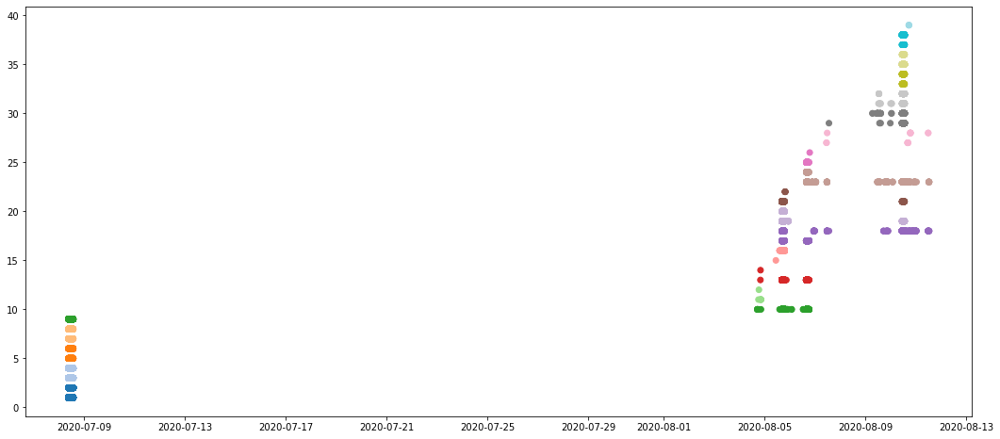

In [43]:
fig,axes=plt.subplots(figsize=(18,8))
plt.scatter(x=data['filename_ts'],y=data['y'],
          color=matplotlib.cm.ScalarMappable(norm=norm, cmap=cmap).to_rgba(data['y']),marker='o')

In [44]:
data['hour']=list(map(lambda x:x.hour,data['filename_ts']))

In [45]:
data['day']=list(map(lambda x:x.day,data['filename_ts']))

In [46]:
count=data.groupby(['day','hour']).count()['y']

In [47]:
count.unstack().fillna(0)

hour,0,1,6,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
day,,,,,,,,,,,,,,,,,,
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,3.0,0.0,8.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,5.0,10.0,9728.0,19202.0,15433.0,297.0,6.0,3.0,9.0,0.0
6,0.0,2.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1942.0,4894.0,3911.0,62.0,1.0,0.0,13.0,3.0,20.0
7,13.0,0.0,0.0,0.0,0.0,31.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,20091.0,24106.0,23958.0,24199.0,14569.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,2.0,0.0,1.0,18.0,6.0,20.0,10.0,0.0,0.0,3.0,10.0,0.0,13.0,16.0,0.0,1.0
10,4.0,5.0,0.0,0.0,0.0,3896.0,5130.0,2417.0,9.0,14.0,10.0,21.0,14.0,4.0,1.0,26.0,15.0,3.0
11,17.0,0.0,0.0,0.0,0.0,11.0,13.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


<AxesSubplot:xlabel='day,hour'>

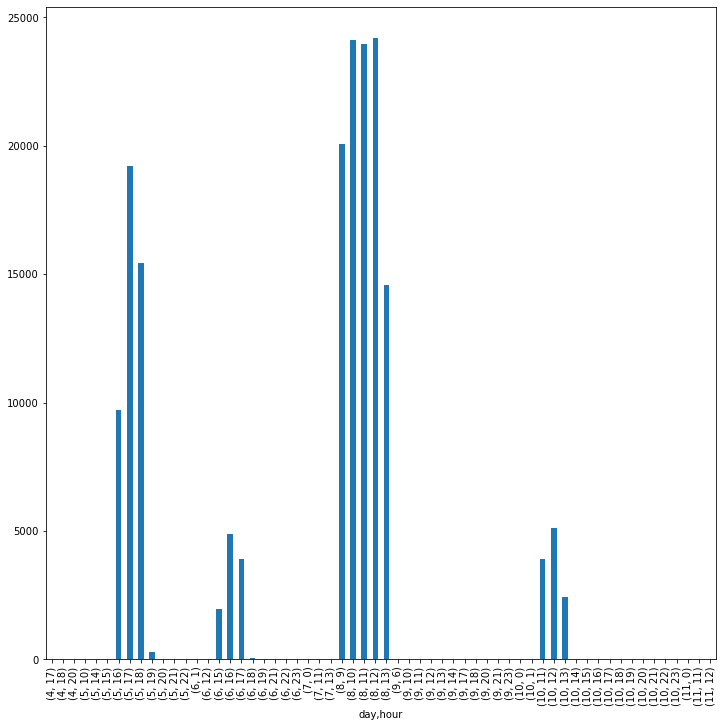

In [48]:
fig,ax=plt.subplots(figsize=(12,12))
count.plot(kind='bar')

In [49]:
fig.savefig("hourly.png",bbox_inches='tight')

In [50]:
data2=pd.read_csv('tr.csv',names=['spp_id','filename_ts'],header=None,skiprows=[0])

In [51]:
data2.head()

,spp_id,filename_ts
0,MLCAP000105,2020-08-05 07:19:00
1,MLCAP000105,2020-08-05 07:19:00
2,MLCAP000105,2020-08-05 07:19:00
3,MLCAP000105,2020-08-05 07:19:00
4,MLRES000398,2020-08-05 07:19:00


In [52]:
data2['filename_ts']=pd.to_datetime(data2['filename_ts'])

In [53]:
boolean=data['spp_id'].isin(data2['spp_id']).sum()

In [54]:
boolean

0

0 duplicate spp_id

1 duplicate time

number data 1 in data 2

In [55]:
boolean=data[['spp_id','filename_ts']].isin(data2)
boolean[(data['spp_id']==1) &(data['filename_ts']==1)].count()

spp_id         0
filename_ts    0
dtype: int64

In [56]:
data2['spp_id'].unique()

array(['MLCAP000105', 'MLRES000398', '128614', '126056', '128148',
       '129948', 'MLCAP000121', '126217', '128026', '128027',
       'MLCAP000112', 'MLRES000164', 'MLIND000055', 'MLPOW000066',
       'MLPOW000075', 'MLCAP000108', 'MLRES000353', 'MLCAP000055',
       '129027', 'MLIC000011', 'MLCAP000281', 'MLCAP000262',
       'MLRES000342', 'MLCAP000183', 'MLRES000359', 'MLRES000355',
       '129065', '128833', '128452', 'MLCAP000236', 'MLCAP000280',
       'MLCAP000273', nan, 'MLIC000305', 'MLCAP000150', '128021',
       'MLPOW000113', 'MLELE000042', '128702', 'MLCAP000271',
       'MLRES000278', 'MLRES000276', '129152', 'MLIC000438',
       'MLCAP000266', 'MLLED000042', 'MLRES000372', 'MLCAP000143',
       'MLRES000025', '128842', 'MLTIM000115', '128545', 'MLCAP000329',
       'MLCAP000178', 'MLIND000151', '128723', 'MLRES000664', '128865',
       'MLFUS000018', 'MLRES000170', 'MLTIM000118'], dtype=object)

In [57]:
data['spp_id'].unique()

array([  3459439,   3459733,   3460711,   3461391,   3456242,   3456266,
         4183450,   3456290, 146515104,    101877,    101747,    100853,
          101876,    102384,  31130941,    101279,    101869,    101859,
          178678, 362795382,    100783,    243512,    101871,    101382,
        86380157,    154533,    156134,    100963,    101868,    101030,
          248755,    152867,    101855,    102324,    101396,    101102,
          102282,    101115,    101035], dtype=int64)

In [58]:
import cufflinks as cf

In [59]:
cf.set_config_file(sharing='public',theme='ggplot',offline=True)

In [60]:
data['Spp_id']=data['spp_id'].map(str)

In [61]:
import plotly.express as px

In [62]:
px.scatter(data_frame=data,x='filename_ts',y='y',color='Spp_id')

In [64]:
from scipy.cluster.hierarchy import dendrogram, linkage

In [104]:
import datetime

In [109]:
data['day']=list(map(lambda x:x.day,data['filename_ts']))

In [112]:
data['time']=list(map(lambda x:x.time(),data['filename_ts']))

In [113]:
data.head()

,id,hashkey,spp_id,path,filename_ts,spp_lag,lag,client,dataset,y,hour,day,Spp_id,ts,time
12664,710679,11230002,3459439,NaN,2020-07-08 09:07:50,00:00:00,NaN,mil,b2,1,9,8,3459439,2020-07-08 09:07:50,09:07:50
28487,732384,11230002,3459439,NaN,2020-07-08 09:07:50,NaN,NaN,mil,b2,1,9,8,3459439,2020-07-08 09:07:50,09:07:50
8020,704268,11230002,3459439,NaN,2020-07-08 09:07:50,00:00:00,NaN,mil,b2,1,9,8,3459439,2020-07-08 09:07:50,09:07:50
90399,711016,21210002,3459733,NaN,2020-07-08 09:07:50,NaN,NaN,mil,b2,2,9,8,3459733,2020-07-08 09:07:50,09:07:50
136828,755592,21230002,3459733,NaN,2020-07-08 09:07:50,00:00:00,NaN,mil,b2,2,9,8,3459733,2020-07-08 09:07:50,09:07:50


In [117]:
datat=data.pivot_table(values='y',index='time',columns=['day'],fill_value=0)

In [118]:
datat.head()

day,4,5,6,7,8,9,10,11
time,,,,,,,,
00:02:42,0,0.0,0.0,0,0.0,0,31.0,0
00:02:50,0,0.0,0.0,0,0.0,0,0.0,18
00:31:14,0,0.0,0.0,0,0.0,0,0.0,18
00:31:16,0,0.0,0.0,0,0.0,0,0.0,18
00:36:30,0,0.0,0.0,23,0.0,0,0.0,0


In [119]:
linked=linkage(datat,'ward')

<function matplotlib.pyplot.show(close=None, block=None)>

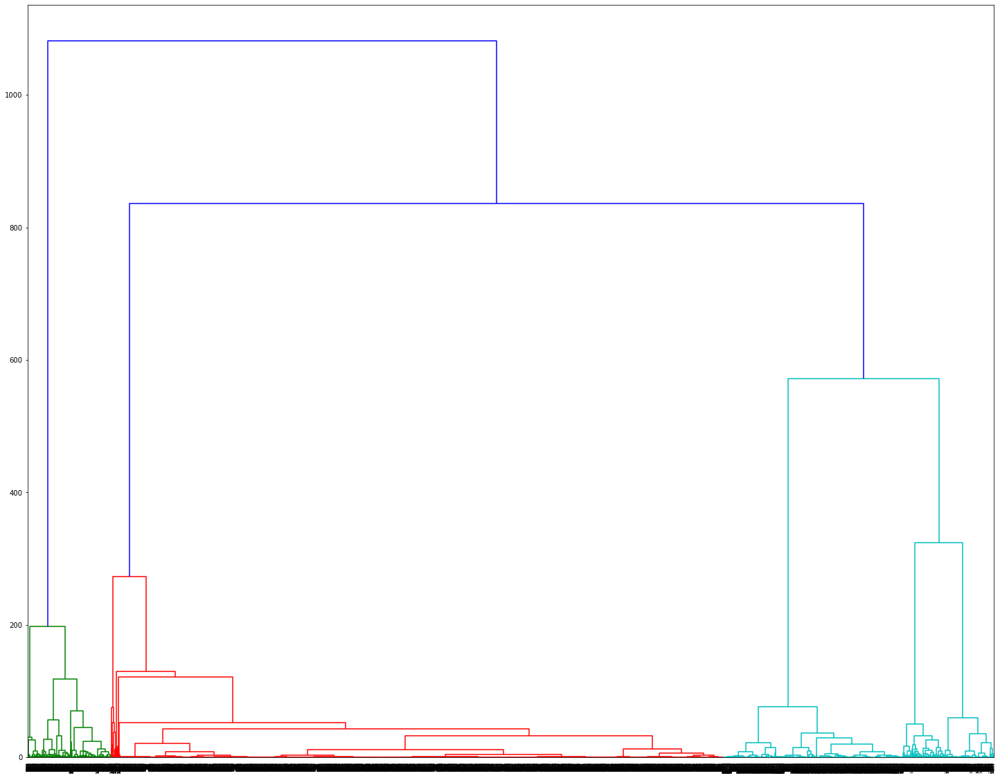

In [123]:
fig=plt.figure(figsize=(25,20))
dendrogram(linked,orientation='top',distance_sort='descending',show_leaf_counts=True)
plt.show

In [126]:
from sklearn.cluster import AgglomerativeClustering

In [127]:
n=4

In [129]:
cluster = AgglomerativeClustering(n_clusters=n, affinity='euclidean', linkage='ward')
cluster.fit_predict(datat)

array([1, 2, 2, ..., 0, 2, 1], dtype=int64)

In [131]:
import plotly.figure_factory as f

In [134]:
fig = f.create_dendrogram(datat)
fig.update_layout(width=1200, height=1000)
fig.show()